# longyearbyen_test

In [529]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
print("Using Oogeso version {}".format(oogeso.__version__))


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read input data

In [530]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_airport.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [531]:
merged

,timestamp,el_load,heat_load,V25,V47,TUGE50,TUGE10,MPR,local_time,PV
0,2017-01-01 00:00:00,4.81,7.466778,0.000000,0.000000,0.000000,0.000000,0.000000,2017-01-01 01:00:00,0.0
1,2017-01-01 01:00:00,4.33,7.551868,0.399499,0.556632,0.677735,0.782709,0.470756,2017-01-01 02:00:00,0.0
2,2017-01-01 02:00:00,4.54,7.573140,0.399499,0.556632,0.677735,0.782709,0.470756,2017-01-01 03:00:00,0.0
3,2017-01-01 03:00:00,4.69,7.573140,0.307258,0.445659,0.612891,0.685810,0.360826,2017-01-01 04:00:00,0.0
4,2017-01-01 04:00:00,4.30,7.573140,0.293578,0.427252,0.602084,0.669441,0.343439,2017-01-01 05:00:00,0.0
...,...,...,...,...,...,...,...,...,...,...
17515,2018-12-31 19:00:00,5.26,10.139872,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 20:00:00,0.0
17516,2018-12-31 20:00:00,5.16,9.826704,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 21:00:00,0.0
17517,2018-12-31 21:00:00,5.12,9.640496,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 22:00:00,0.0
17518,2018-12-31 22:00:00,4.99,9.513536,0.000000,0.000000,0.000000,0.000000,0.000000,2018-12-31 23:00:00,0.0


In [532]:
#case='base' # base case without wind
#case='A' # case with 24 MW wind capacity
#case='B' # case with 24 MW wind capacity AND 4 MW, 4 MWh battery
#case="_base_test"
case="_ir_offshore_pv"
case="_ir_offshore_pv_diesel"
#case="all"
#timerange=[0,12*24*7] #one week (with 5 min timestep)
timerange=[0,24*365] #one year (with 1 hour timestep)
#timerange=[0,24*7] #one week (with 1 hour timestep)
#timerange=[0,4]
#timerange=[1030,1050] #no wind period

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml('../tests/test_data/longyearbyen_test.yaml')

incl_battery=0
incl_hydrogen=0
incl_diesel=0

if case=="_ir_offshore_pv":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)

elif case=="_ir_offshore_pv_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    incl_diesel=1
    data.parameters.co2_tax=1000

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

#data['paramParameters']['planning_horizon']=12

if case=="base_test":
    wind_P_max=0.66*8 # Some turbines
    pv_P_max=25 # MWp Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)
elif case=="all":
    # CASE for illustration (to make plots for paper)
    wind_P_max=8*12 # Large wind farm Pmax=2x demand
    incl_battery=1
    incl_hydrogen=1
    data.parameters.co2_tax=1000
    prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    data.profiles.append(prof_h2target)


hydrogendevices = ['electrolyser','fuelcell','h2_storage']
dieseldevices = ['diesel_source','backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3','diesel_boiler_1','diesel_boiler_2','boiler_houses']
for dev in data.devices:
    if dev.id == "wind":
        dev.flow_max = wind_P_max
        dev.profile = wind_profile
    if dev.id == "pv":
        dev.flow_max = pv_P_max
    if dev.id == "el_storage":
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in dieseldevices:
        dev.include = incl_diesel

simulator = oogeso.Simulator(data)

In [533]:
for dev in data.devices:
    if dev.id=='el_load':
        print(dev)

id='el_load' node_id='load' name='general el load' include=True profile='el_load' flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=None penalty_function=None model=<ModelType.SINK_EL: 'sinkel'>


In [534]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")

{'Problem': [{'Name': 'x146182', 'Lower bound': 0.007974999999999998, 'Upper bound': 0.007975, 'Number of objectives': 1, 'Number of constraints': 34059, 'Number of variables': 32642, 'Number of binary variables': 8160, 'Number of integer variables': 8160, 'Number of continuous variables': 24482, 'Number of nonzeros': 74250, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '0.23496437072753906', 'Error rc': 0, 'Time': 0.9119937419891357}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [535]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [536]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=21, Index=setDevice, Domain=Reals, Default=None, Mutable=True
    Key             : Value
      backup_east_1 :        0
      backup_east_2 :        0
      backup_east_3 :        0
      backup_west_1 :        0
      backup_west_2 :        0
      backup_west_3 :        0
      boiler_houses :        0
    diesel_boiler_1 :        0
    diesel_boiler_2 :        0
      diesel_source :        0
            el_dump :        0
            el_load :        0
         el_storage :      3.0
       electrolyser :        0
           fuelcell :        0
         h2_storage : 500000.0
          heat_dump :        0
          heat_load :        0
           heatpump :        0
                 pv :        0
               wind :        0


In [537]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [538]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=960, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                : Value
             ('PV', 0) :     1
             ('PV', 1) :     1
             ('PV', 2) :     1
             ('PV', 3) :     1
             ('PV', 4) :     1
             ('PV', 5) :     1
             ('PV', 6) :     1
             ('PV', 7) :     1
             ('PV', 8) :     1
             ('PV', 9) :     1
            ('PV', 10) :     1
            ('PV', 11) :     1
            ('PV', 12) :     1
            ('PV', 13) :     1
            ('PV', 14) :     1
            ('PV', 15) :     1
            ('PV', 16) :     1
            ('PV', 17) :     1
            ('PV', 18) :     1
            ('PV', 19) :     1
            ('PV', 20) :     1
            ('PV', 21) :     1
            ('PV', 22) :     1
            ('PV', 23) :     1
            ('PV', 24) :     1
            ('PV', 25) :     1
            ('PV', 26) :     1
            ('PV', 27) :     1
       

### Inspect input data

In [539]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(asdict(data)[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [540]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [541]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_hp True
heat_hp_load True
el_diesel_load True
heat_diesel_load True


0 2016


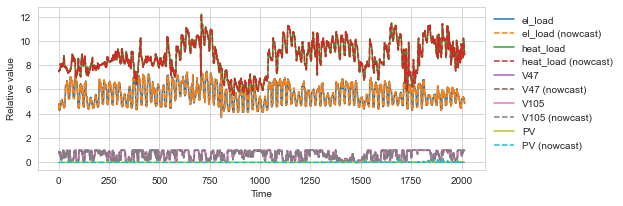

In [542]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [543]:
outpath

'result/'

In [544]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

In [545]:
dev=simulator.optimiser.all_devices['wind'].dev_data
#fuelA = dev.fuel_A
#fuelB = dev.fuel_B
Pmax = dev.flow_max
#plots.plotGasTurbineEfficiency(filename='gasturbine_Gen1.png',fuelA=fuelA,fuelB=fuelB,Pmax=Pmax)

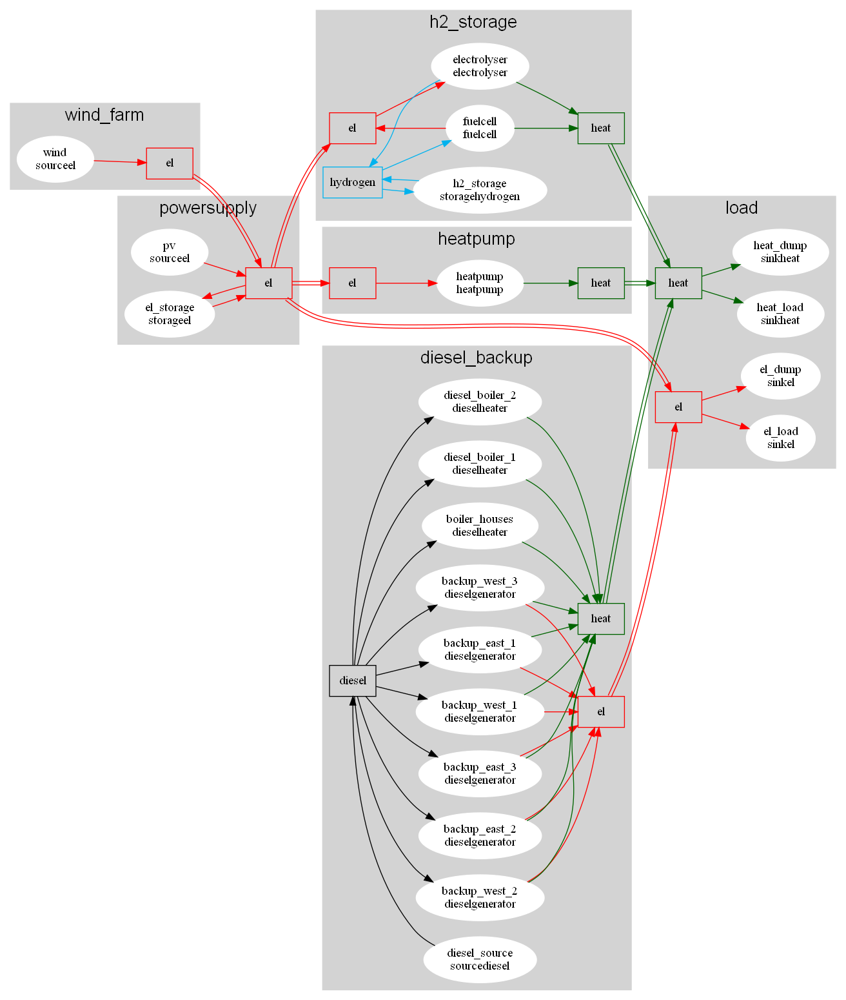

In [546]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))

### Some checks on input data

In [547]:
25.12, 25.063, 25.081

(25.12, 25.063, 25.081)

In [548]:
print(simulator.optimiser.all_edges['heat_hp_load'].edge_data)

id='heat_hp_load' node_from='heatpump' node_to='load' length_km=None flow_max=None bidirectional=True include=True carrier=<CarrierType.HEAT: 'heat'> power_loss_function=None


## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [549]:
dev_d=simulator.optimiser.all_devices["wind"].dev_data
node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [550]:
#simulator.optimiser.write("testplatform.mps")
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=20)
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))
#print("Mean export revenue         =",*["{}:{:.1f} ".format(x,v) for x,v in sim_result.export_revenue.mean().items() if v!=0],"$/s")

100%|██████████| 365/365 [48:59<00:00,  8.05s/it]

Mean CO2 emission rate      = 0.1 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [551]:
sim_result.co2_intensity

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
8755   NaN
8756   NaN
8757   NaN
8758   NaN
8759   NaN
Length: 8760, dtype: float64

In [552]:
sim_result.co2_rate

0       0.000000
1       0.000000
2       0.000000
3       0.000000
4       0.000000
          ...   
8755    0.762657
8756    0.739103
8757    0.627290
8758    0.688778
8759    0.577706
Length: 8760, dtype: float64

In [553]:
sum(sim_result.co2_rate*3600) #co2-emissions for the entire simulation period [kg]

3815671.6425156295

In [554]:
print(simulator.optimiser.all_devices['backup_east_1'].compute_CO2(simulator.optimiser, [1]))

2640.0*varDeviceFlow[backup_east_1,diesel,in,1]


In [555]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 1573356000624)

In [556]:
#simulator.optimiser.constr_injectionwell_Pmax.pprint()
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])
#simulator.optimiser.constrE_w2_flow.pprint()

4.005000000000001

In [557]:
print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
    pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["heatpump",6]),
)

0.2963503312097857 1 1 1


## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [604]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   pickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

PicklingError: Can't pickle <class 'oogeso.dto.carriers.CarrierElData'>: it's not the same object as oogeso.dto.carriers.CarrierElData

In [ ]:
dumpdata

{'data': EnergySystemData(parameters=OptimisationParametersData(objective='costs', time_delta_minutes=60, planning_horizon=240, optimisation_timesteps=24, forecast_timesteps=24, co2_tax=1000, emission_intensity_max=-1.0, emission_rate_max=-1.0, piecewise_repn='SOS2', optimisation_return_data=None), carriers=[CarrierElData(id='el', powerflow_method='transport', reference_node=None, el_reserve_margin=5.0, el_backup_margin=-1.0, reserve_storage_minutes=30), CarrierHeatData(id='heat'), CarrierHydrogenData(id='hydrogen', energy_value=13.0), CarrierDieselData(id='diesel', energy_value=39, co2_content=2.64)], nodes=[NodeData(id='wind_farm'), NodeData(id='powersupply'), NodeData(id='load'), NodeData(id='h2_storage'), NodeData(id='heatpump'), NodeData(id='diesel_backup')], edges=[EdgeElData(id='el_wf_ps', node_from='wind_farm', node_to='powersupply', length_km=60.0, flow_max=500.0, bidirectional=True, include=True, carrier=<CarrierType.EL: 'el'>, resistance=0.001, reactance=0.01, voltage=None, 

In [559]:
# Open previously saved object (including simulation results)
#with open(pickle_save, mode='rb') as file:
#   sim_data = cloudpickle.load(file)
#data=sim_data["data"]
#sim_result=sim_data["result"]

## Analyse results

In [560]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel")#, windturbines=['wind'])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi 

,_ir_offshore_pv_diesel
hours_simulated,8.760000e+03
kgCO2_per_year,3.815672e+06
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,1.445330e+03
elconsumption_mwh_per_year,1.133653e+05
elconsumption_avg_mw,1.294125e+01
gt_starts_per_year,4.479000e+03
gt_stops_per_year,4.477000e+03
gt_hoursrunning_per_year,2.798000e+03
wind_output_mwh_per_year,0.000000e+00


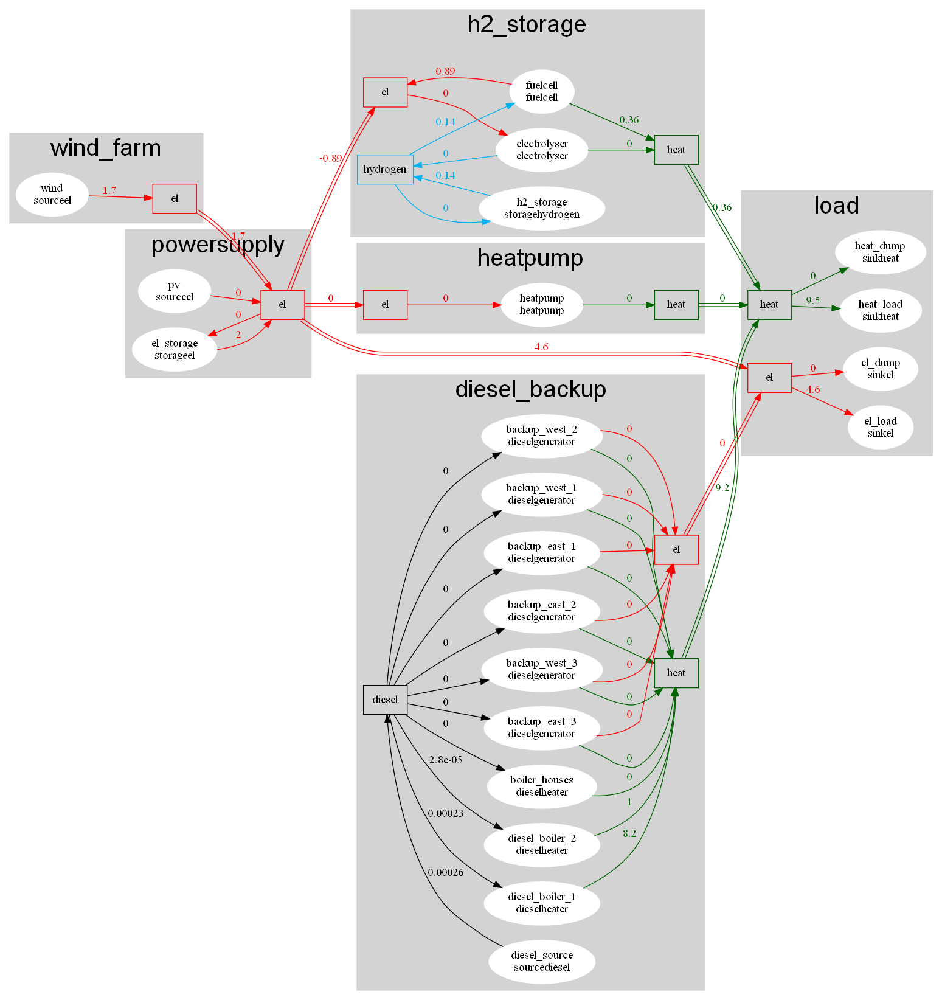

In [561]:
tstep=8758
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [562]:
print(sim_result.device_flow.el_load.el["in"].to_string())

time
0       4.81000
1       4.33000
2       4.54000
3       4.69000
4       4.30000
5       4.48000
6       4.53000
7       4.54000
8       4.62000
9       4.68000
10      4.80000
11      4.87000
12      4.99000
13      5.06000
14      5.15000
15      5.17000
16      5.17000
17      5.05000
18      4.97000
19      4.94000
20      4.90000
21      4.83000
22      4.80000
23      4.69000
24      4.56000
25      4.53000
26      4.55000
27      4.49000
28      4.54000
29      4.61000
30      4.73000
31      5.17000
32      5.51000
33      6.20000
34      6.38000
35      6.32000
36      6.30000
37      6.33000
38      6.34000
39      6.44000
40      6.72000
41      6.64000
42      6.62000
43      6.47000
44      5.82000
45      6.34000
46      6.15000
47      5.70000
48      5.32000
49      5.23000
50      5.21000
51      5.22000
52      5.24000
53      5.29000
54      5.51000
55      5.95000
56      6.80000
57      7.01000
58      7.04000
59      6.93400
60      6.80000
61      6.95000
62 

In [563]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.000000e+00
                    1       0.000000e+00
                    2       0.000000e+00
                    3       0.000000e+00
                    4       0.000000e+00
                    5       0.000000e+00
                    6       0.000000e+00
                    7       0.000000e+00
                    8       0.000000e+00
                    9       0.000000e+00
                    10      0.000000e+00
                    11      0.000000e+00
                    12      0.000000e+00
                    13      0.000000e+00
                    14      0.000000e+00
                    15      0.000000e+00
                    16      0.000000e+00
                    17      0.000000e+00
                    18      0.000000e+00
                    19      0.000000e+00
                    20      0.000000e+00
                    21      0.000000e+00
                    22      0.000000e+00
                    23      0.00

In [564]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [565]:
plots.plotter='matplotlib'
fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el")#,filename=None,devs_shareload=["wind","pv"])#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutput_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

,el,heat
device,,
backup_east_1,0.000000e+00,0.000000e+00
backup_east_2,0.000000e+00,0.000000e+00
backup_east_3,0.000000e+00,0.000000e+00
backup_west_1,0.000000e+00,0.000000e+00
backup_west_2,0.000000e+00,0.000000e+00
backup_west_3,0.000000e+00,0.000000e+00
boiler_houses,0.000000e+00,0.000000e+00
diesel_boiler_1,0.000000e+00,0.000000e+00
diesel_boiler_2,0.000000e+00,0.000000e+00


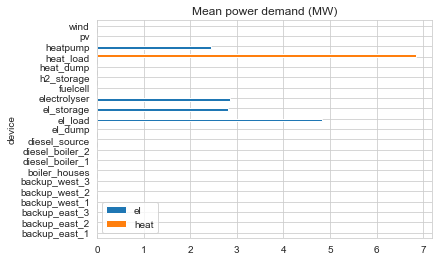

In [566]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [567]:
energydemand.sum()

el      12.941249
heat     6.844884
dtype: float64

In [568]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000046
          out          0.000046
el        in          12.941249
          out         12.941249
heat      in           6.844884
          out          6.844884
hydrogen  in           0.293733
          out          0.293733
dtype: float64
Mean flow per device:


carrier            diesel                      el                    heat  \
terminal               in       out            in       out            in   
device                                                                      
backup_east_1    0.000000  0.000000  0.000000e+00  0.000000  0.000000e+00   
backup_east_2    0.000000  0.000000  0.000000e+00  0.000000  0.000000e+00   
backup_east_3    0.000000  0.000000  0.000000e+00  0.000000  0.000000e+00   
backup_west_1    0.000002  0.000000  0.000000e+00  0.031040  0.000000e+00   
backup_west_2    0.000002  0.000000  0.000000e+00  0.032191  0.000000e+00   
backup_west_3    0.000002  0.000000  0.000000e+00  0.029501  0.000000e+00   
boiler_houses    0.000000  0.000000  0.000000e+00  0.000000  0.000000e+00   
diesel_boiler_1  0.000017  0.000000  0.000000e+00  0.000000  0.000000e+00   
diesel_boiler_2  0.000022  0.000000  0.000000e+00  0.000000  0.000000e+00   
diesel_source    0.000000  0.000046  0.000000e+00  0.000000  0.000000e+00   
el_dump          0.000000  0.000000 -4.875530e-11  0.000000  0.000000e+00   
el_load          0.000000  0.000000  4.832654e+00  0.000000  0.000000e+00   
el_storage       0.000000  0.000000  2.804131e+00  2.804131  0.000000e+00   
electrolyser     0.000000  0.000000  2.855315e+00  0.000000  0.000000e+00   
fuelcell         0.000000  0.000000  0.000000e+00  0.999632  0.000000e+00   
h2_storage       0.000000  0.000000  0.000000e+00  0.000000  0.000000e+00   
heat_dump        0.000000  0.000000  0.000000e+00  0.000000  4.198516e-07   
heat_load        0.000000  0.000000  0.000000e+00  0.000000  6.844884e+00   
heatpump         0.000000  0.000000  2.449150e+00  0.000000  0.000000e+00   
pv               0.000000  0.000000  0.000000e+00  2.001293  0.000000e+00   
wind             0.000000  0.000000  0.000000e+00  7.043462  0.000000e+00   

carrier                    hydrogen            
terminal              out        in       out  
device                                         
backup_east_1    0.000000  0.000000  0.000000  
backup_east_2    0.000000  0.000000  0.000000  
backup_east_3    0.000000  0.000000  0.000000  
backup_west_1    0.000000  0.000000  0.000000  
backup_west_2    0.000000  0.000000  0.000000  
backup_west_3    0.000000  0.000000  0.000000  
boiler_houses    0.000000  0.000000  0.000000  
diesel_boiler_1  0.607557  0.000000  0.000000  
diesel_boiler_2  0.764430  0.000000  0.000000  
diesel_source    0.000000  0.000000  0.000000  
el_dump          0.000000  0.000000  0.000000  
el_load          0.000000  0.000000  0.000000  
el_storage       0.000000  0.000000  0.000000  
electrolyser     0.174745  0.000000  0.140569  
fuelcell         0.399853  0.153789  0.000000  
h2_storage       0.000000  0.139943  0.153164  
heat_dump        0.000000  0.000000  0.000000  
heat_load        0.000000  0.000000  0.000000  
heatpump         4.898299  0.000000  0.000000  
pv               0.000000  0.000000  0.000000  
wind             0.000000  0.000000  0.000000

In [596]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [570]:
 df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
 df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8750, 8751, 8752, 8753, 8754, 8755, 8756, 8757, 8758, 8759],
           dtype='int64', name='time', length=8760)

In [571]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
fig.add_scatter(
                x=df.index,
                y=df["wind"],
                line_shape="hv",
                name="wind",
                #line=dict(color=colour[k]),
                stackgroup="P",
                legendgroup="wind",
                row=1,
                col=1,
            )

In [572]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['heatpump',t].value
    dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
    dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [573]:
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [574]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

ValueError: Length mismatch: Expected axis has 21 elements, new values have 2 elements

In [575]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   21 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'heatpump', 'heat_dump', 'el_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [576]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [599]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',
                                 filename=None)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [591]:
simulator.optimiser.all_devices["h2_storage"].dev_data.model

<ModelType.STORAGE_HYDROGEN: 'storagehydrogen'>

In [601]:
plots.plotter="plotly"
#fig=plots.plot_co2_rate_per_dev(sim_result,simulator.optimiser,reverseLegend=True,filename=outpath+"co2rate_opt.png",devs_shareload=gts)
#fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

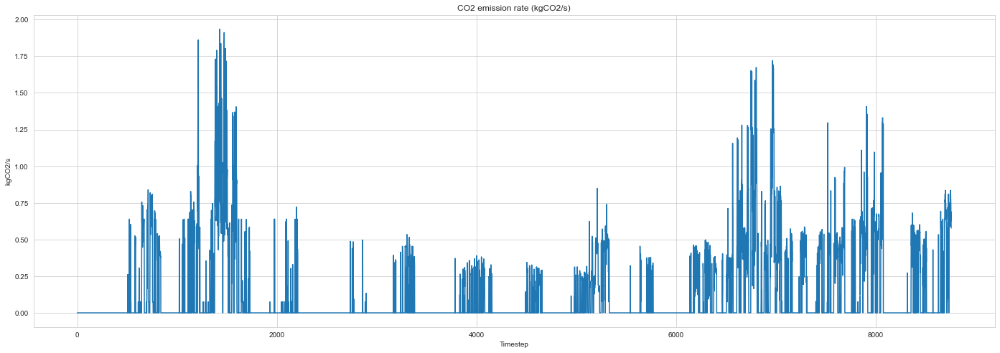

In [603]:
fig = plots.plot_CO2_rate(sim_result)

In [579]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

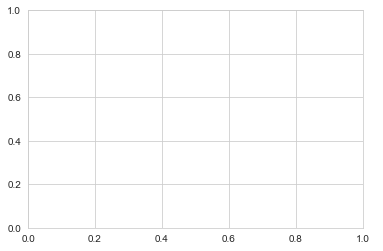

In [580]:
plots.plotter="matplotlib"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False)
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
#fig.update_layout(autosize=False,width=700,height=200,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
#fig.update_layout(legend_traceorder="reversed")
#fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [581]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [582]:
fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
fig.show()
fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [583]:
simulator.optimiser.all_devices

{'wind': <oogeso.core.devices.source.SourceEl at 0x16da1225780>,
 'pv': <oogeso.core.devices.source.SourceEl at 0x16dfda85210>,
 'el_load': <oogeso.core.devices.sink.SinkEl at 0x16dfda84850>,
 'heat_load': <oogeso.core.devices.sink.SinkHeat at 0x16dfda85090>,
 'electrolyser': <oogeso.core.devices.electrolyser.Electrolyser at 0x16dedcff5e0>,
 'fuelcell': <oogeso.core.devices.fuelcell.FuelCell at 0x16da3369390>,
 'h2_storage': <oogeso.core.devices.storage.StorageHydrogen at 0x16dfbcadde0>,
 'el_storage': <oogeso.core.devices.storage.StorageEl at 0x16de5208160>,
 'heatpump': <oogeso.core.devices.heatpump.HeatPump at 0x16de5208850>,
 'heat_dump': <oogeso.core.devices.sink.SinkHeat at 0x16de5208970>,
 'el_dump': <oogeso.core.devices.sink.SinkEl at 0x16de520ab90>,
 'diesel_source': <oogeso.core.devices.source.SourceDiesel at 0x16e571774c0>,
 'backup_east_1': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x16e57175450>,
 'backup_east_2': <oogeso.core.devices.dieselgenerator.DieselGe